In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch

from pathlib import Path
from cellpose import models
from matplotlib.colors import Normalize
from sklearn.preprocessing import minmax_scale
from scipy.ndimage import binary_dilation

from data import Dataset
from component_analysis import ImagePCA
from normalize_background import fit_polynomial_background

# Red Blood Cell Background Normalization

This notebook contains the pipeline for normalization of images based on estimating the background by fitting a polynomial plane. This method is capable of normalizing the background both within an image and between images and datasets. Normalization is performed in a few steps: 
1. Estimating which pixels in the image correspond to the background through filtering, binary dilation, cell segmentation and thresholding. 
2. Fitting a second-degree polynomial plane to the background pixels. The background is assumed to be quite smooth, and the complexity of the background plane is limited to second-degree to ensure we do not overfit to noise, we want to capture the large, smooth changes in the background. 
3. Subtracting the estimated background plane to bring the background to 0, thus achieving normalization both within an image and between images. 

This approach works under the assumptions that the source of the variations in the data affects both red blood cells and background equally. Based on results found here, this is arguably debatable. To further investigate how well this method works, we need a quantative evaluation method of normalization. This is not currently implemented. 

# Load Data

Load data by creating a dataset. Specify file paths either by creating a .env file as described by README.md or manually writing the paths to the dataset folders. 

In [58]:
# Get dataset paths from .env file
dataset_path_1 = Path(os.getenv('DATASET_PATH_1')) / 'img_raw'
dataset_path_2 = Path(os.getenv('DATASET_PATH_2')) / 'img_raw'

# Alternatively, manually write the correct paths in the following lines: 
# dataset_path_1 = Path('C:/.../toy1/')
# dataset_path_1 = Path('C:/.../toy2/')

# Create dataset
dataset = Dataset([dataset_path_1, dataset_path_2])

Visualize channel averages of an example image

90
(13, 1190, 1590)
(13, 1190, 1590)
(13, 1190, 1590)


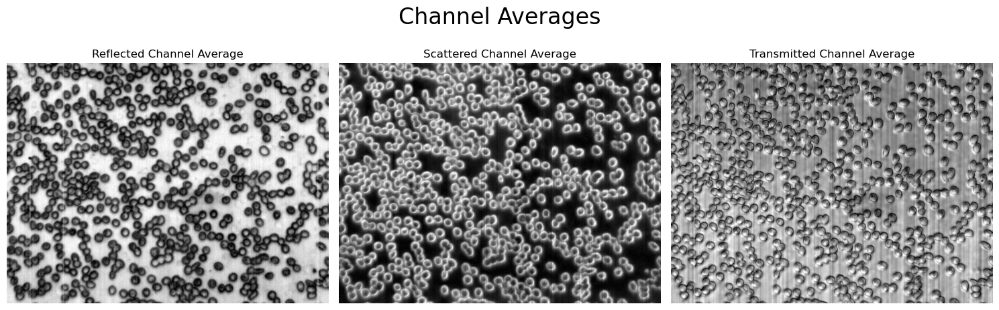

In [59]:
# Select a random image
idx = np.random.randint(0, len(dataset))
# idx = 72
data = dataset[idx]
print(idx)

# Extract reflected, scattered, and transmitted images
image_R = data['R']
image_S = data['S']
image_T = data['T']

# Remove a few pixels closest to the edges. Sometimes, there are 0s 
# in the raw data at the edges, which can confuse our normalization.
n_edge_pixels = 5
image_R = image_R[:, n_edge_pixels:-n_edge_pixels, n_edge_pixels:-n_edge_pixels]
image_S = image_S[:, n_edge_pixels:-n_edge_pixels, n_edge_pixels:-n_edge_pixels]
image_T = image_T[:, n_edge_pixels:-n_edge_pixels, n_edge_pixels:-n_edge_pixels]

print(image_R.shape)
print(image_S.shape)
print(image_T.shape)

# Show channel averages
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(minmax_scale(image_R.mean(0)), cmap='gray', vmin=0, vmax=1)
axs[1].imshow(minmax_scale(image_S.mean(0)), cmap='gray', vmin=0, vmax=1)
axs[2].imshow(minmax_scale(image_T.mean(0)), cmap='gray', vmin=0, vmax=1)
axs[0].set_title("Reflected Channel Average")
axs[1].set_title("Scattered Channel Average")
axs[2].set_title("Transmitted Channel Average")
for ax in axs:
    ax.axis(False)
plt.suptitle("Channel Averages", fontsize=24)
plt.tight_layout()
plt.show()

Visualize the example image principal components to better see variations across the image. Note that by looking at the average intensity, we do not see much variation. Looking at the principal channel components however, the variance is better viewed. 

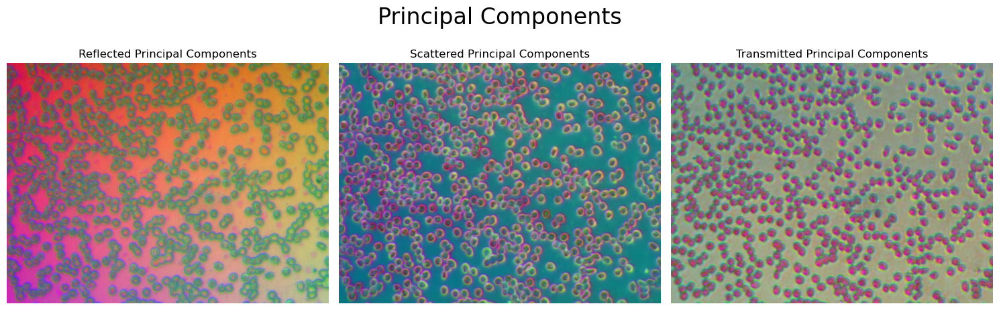

In [60]:
# Fit PCA to data and compute principal components for visualization
pca_R = ImagePCA(n_components=3)
pca_S = ImagePCA(n_components=3)
pca_T = ImagePCA(n_components=3)

pca_R.fit(image_R)
pca_S.fit(image_S)
pca_T.fit(image_T)

principal_components_image_R = pca_R.transform(image_R)[0]
principal_components_image_S = pca_S.transform(image_S)[0]
principal_components_image_T = pca_T.transform(image_T)[0]

# Rescale to range [0,1]
min_R = np.min(principal_components_image_R, (1,2))
max_R = np.max(principal_components_image_R, (1,2))
principal_components_image_R = (principal_components_image_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]
min_S = np.min(principal_components_image_S, (1,2))
max_S = np.max(principal_components_image_S, (1,2))
principal_components_image_S = (principal_components_image_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]
min_T = np.min(principal_components_image_T, (1,2))
max_T = np.max(principal_components_image_T, (1,2))
principal_components_image_T = (principal_components_image_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

# Plot results
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

# Normalizing Image Background

We try normalizing the image by fitting a second degree polynomial plane to the background

First, we need to extract pixels corresponding to background

c:\Users\ollee\anaconda3\envs\MultispectralMalariaProject\Lib\site-packages\cellpose\resnet_torch.py:271: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.lo

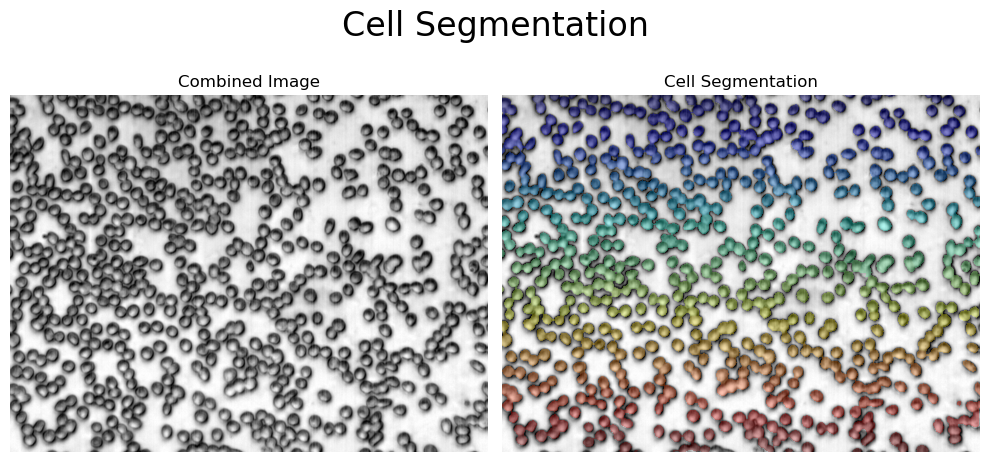

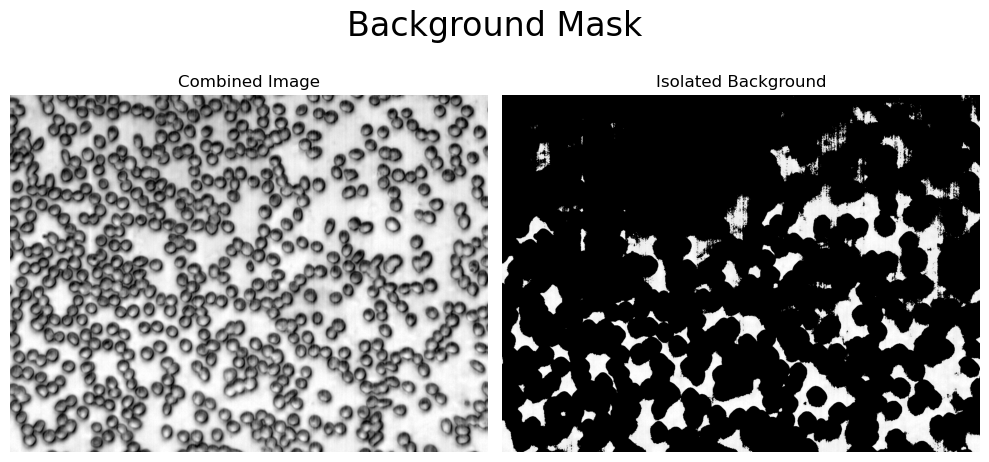

In [61]:
# Function to get background mask
def get_background_mask(image_R, image_S, image_T, segmentation_model, plot=False):
    # Cell segmentation can be performed on a combined image, averaging all channels in
    # reflected, scattered and transmitted images
    combined_image = minmax_scale(image_R.mean(0)-image_S.mean(0)+image_T.mean(0))
    
    # Segment cells
    mask, _, _, _ = segmentation_model.eval(combined_image, channels=[0, 0], diameter=35)

    # Convert into binary mask where 1 indicates cell and 0 indicates background
    background_mask = np.where(mask == 0, 0, 1)

    # Dilude mask a bit
    background_mask = binary_dilation(background_mask, iterations=10)

    # Compute the average value of the background and filter out pixels deviating to 
    # remove pixels the segmentation missed. Assumes that background is quite uniform. 
    intensity_deviation_threshold = 0.01
    background_pixels = combined_image[background_mask == 0]
    mean_intensity = np.mean(background_pixels)
    deviation_mask = (combined_image - mean_intensity) < intensity_deviation_threshold
    background_mask[deviation_mask & (background_mask == 0)] = 1

    # Plot combined image and masks
    if plot:
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        colormap = plt.cm.jet
        colormap.set_under(color='black')
        norm = Normalize(vmin=0.5, vmax=mask.max())
        axes[0].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[0].set_title("Combined Image")
        axes[0].axis(False)
        masked_mask = np.ma.masked_where(mask == 0, mask)
        axes[1].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[1].imshow(masked_mask, cmap=colormap, norm=norm, alpha=0.3)
        axes[1].set_title("Cell Segmentation")
        axes[1].axis(False)
        plt.suptitle("Cell Segmentation", fontsize=24)
        plt.tight_layout()
        plt.show()

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        axes[0].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[0].set_title("Combined Image")
        axes[0].axis(False)
        combined_image[background_mask == 1] = 0
        axes[1].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[1].set_title("Isolated Background")
        axes[1].axis(False)
        plt.suptitle("Background Mask", fontsize=24)
        plt.tight_layout()
        plt.show()

    return background_mask

# Use CellPose for cell segmentation
segmentation_model = models.Cellpose(model_type='cyto3', gpu=True, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

# Get background mask
background_mask = get_background_mask(image_R, image_S, image_T, segmentation_model, plot=True)

Now we can fit a polynomial plane to the background indicated by the background mask

In [62]:
# Function to normalize image based on estimating background plane
def normalize_background(image, background_mask, pca=None):
    # Fit polynomial plane to the background pixels
    normalized_image, fitted_background = fit_polynomial_background(image, background_mask, degree=2)

    # Add back mean value of estimated background to visualize normalization
    normalized_image_with_background = normalized_image + fitted_background.mean((1,2))[:, None, None]

    # Transform to principal components for visualization
    principal_components_normalized_image_with_background = pca.transform(normalized_image_with_background)[0]
    principal_components_fitted_background = pca.transform(fitted_background)[0]
    
    return normalized_image, fitted_background, principal_components_normalized_image_with_background, principal_components_fitted_background

# Normalize images
normalized_image_R, fitted_background_R, principal_components_normalized_image_R, principal_components_fitted_background_R = \
    normalize_background(image_R, background_mask, pca_R)
normalized_image_S, fitted_background_S, principal_components_normalized_image_S, principal_components_fitted_background_S = \
    normalize_background(image_S, background_mask, pca_S)
normalized_image_T, fitted_background_T, principal_components_normalized_image_T, principal_components_fitted_background_T = \
    normalize_background(image_T, background_mask, pca_T)

To visualize the process, the planes at each intermediate stage can be plotted. At the end, the reflected, scattered, and transmitted images are plotted for visual evaluation of normalization. 

Reflected Image Normalization


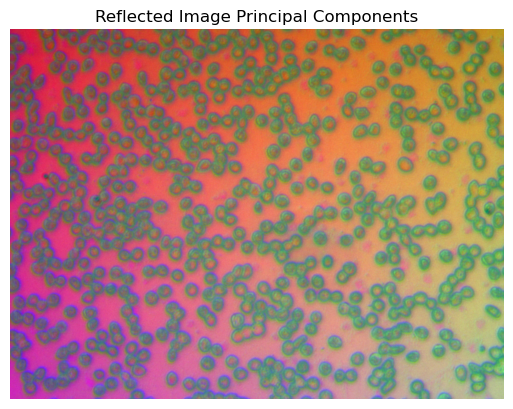

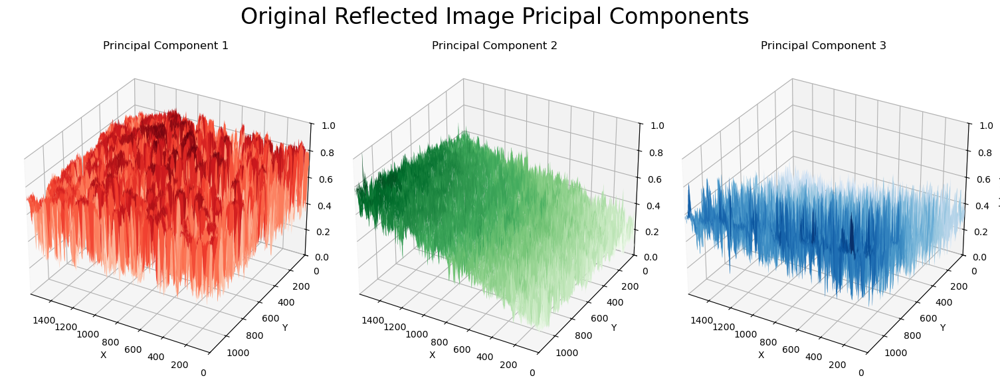

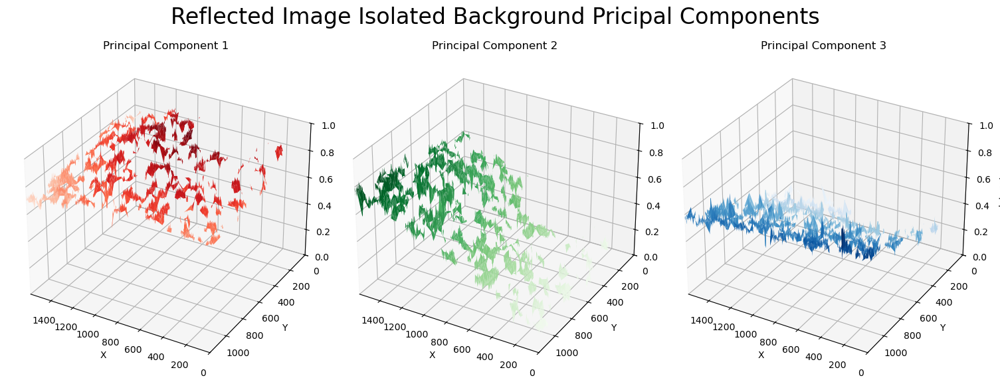

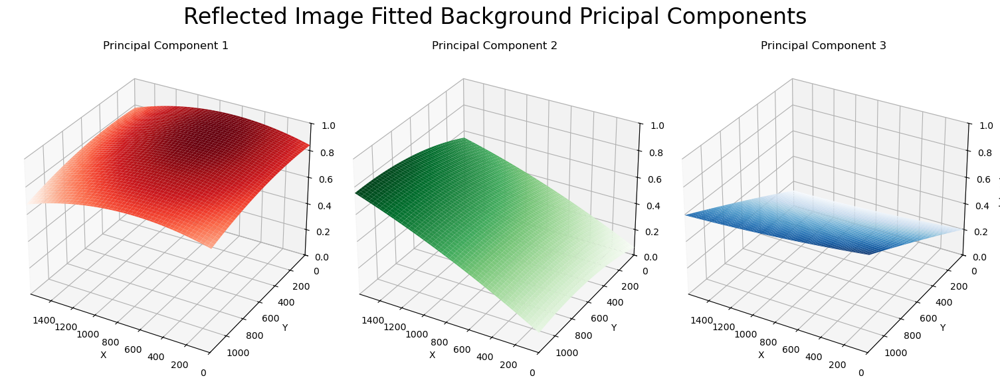

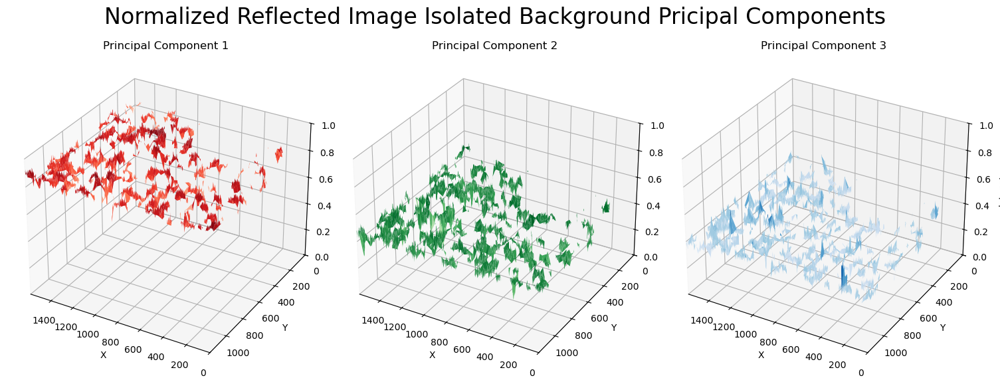

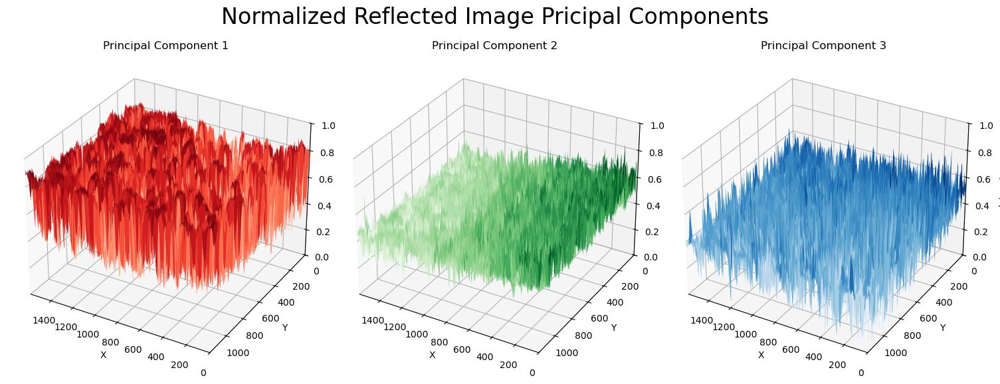

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007826647..0.97353786].


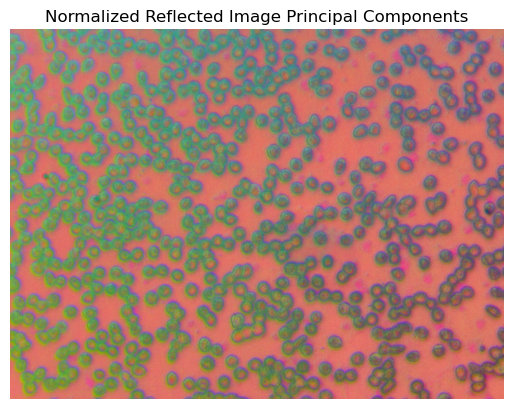

Scattered Image Normalization


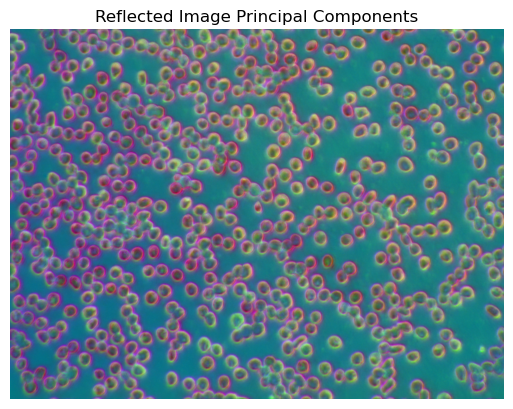

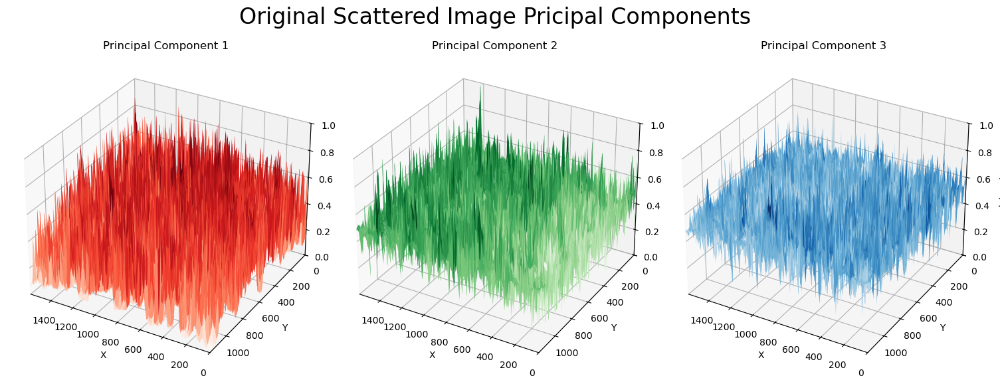

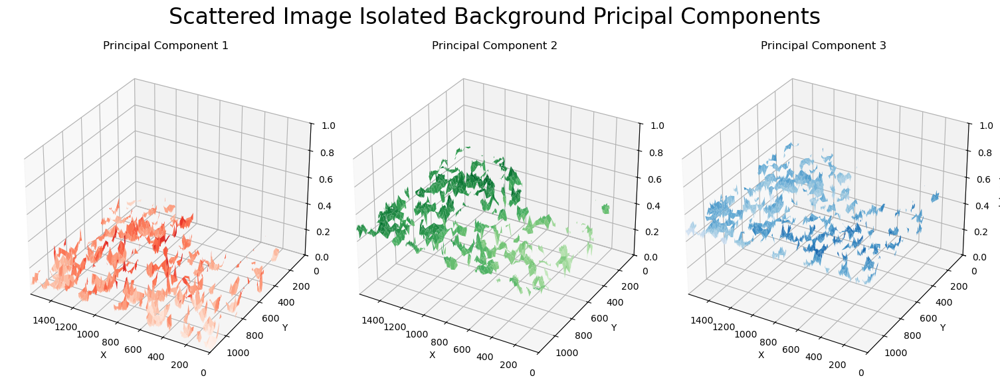

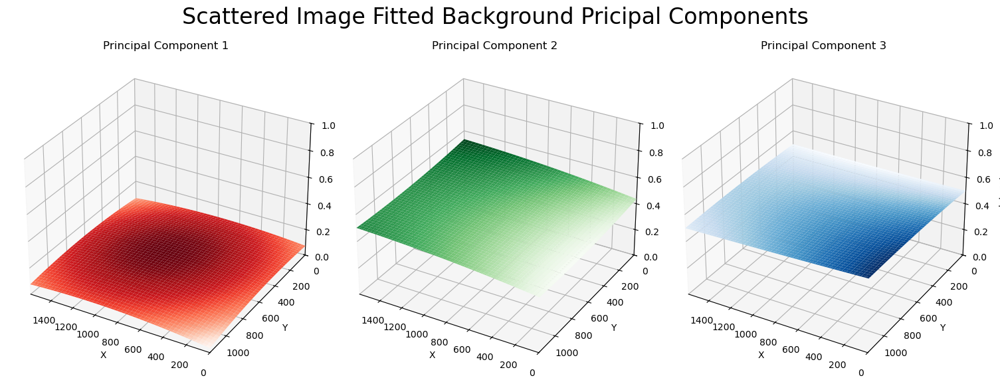

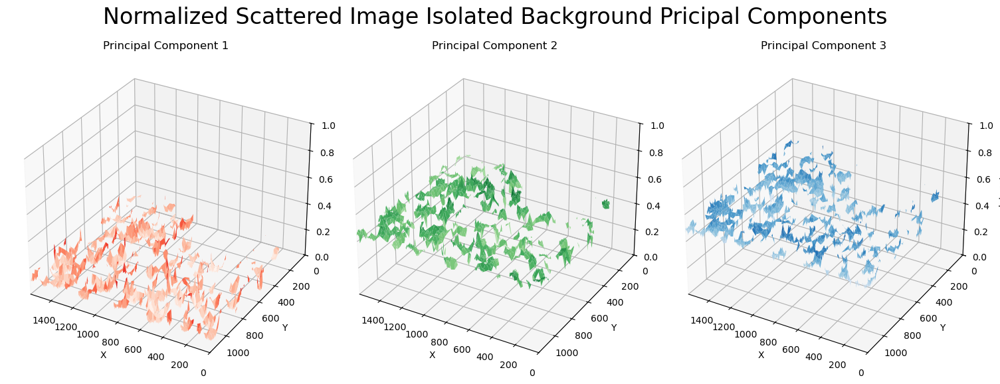

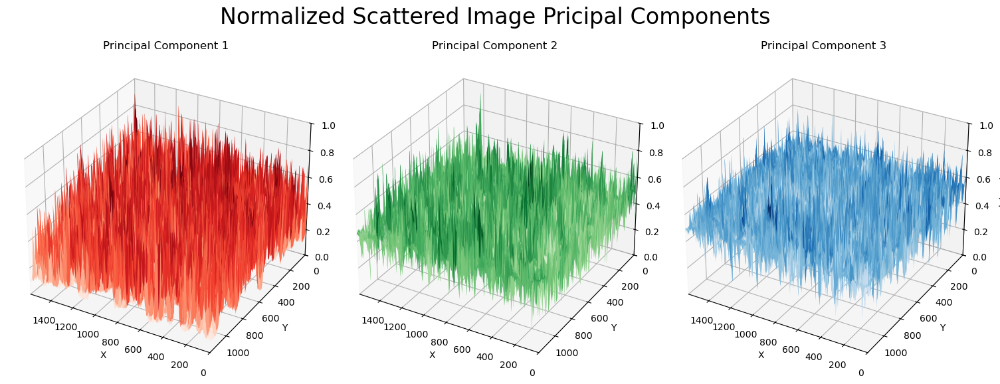

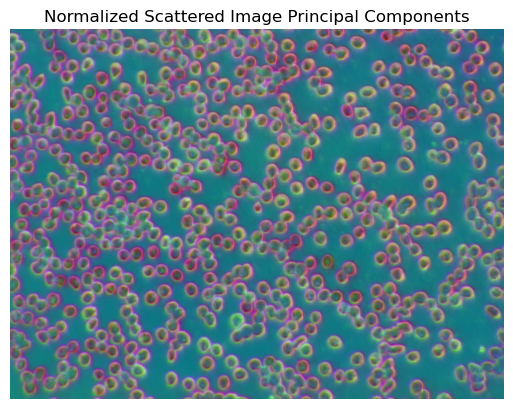

Transmitted Image Normalization


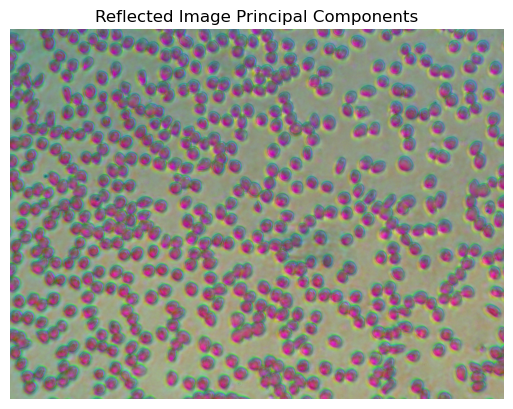

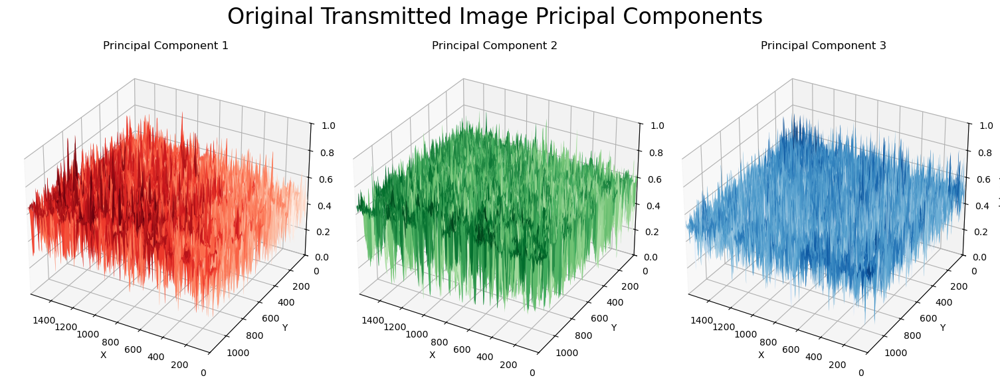

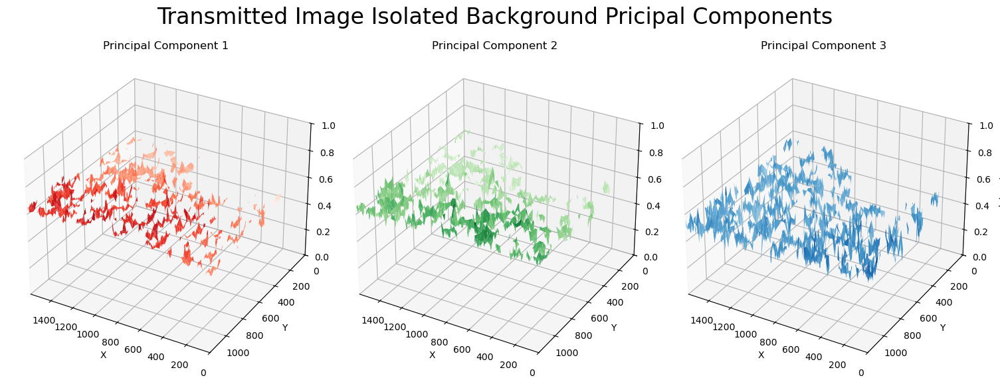

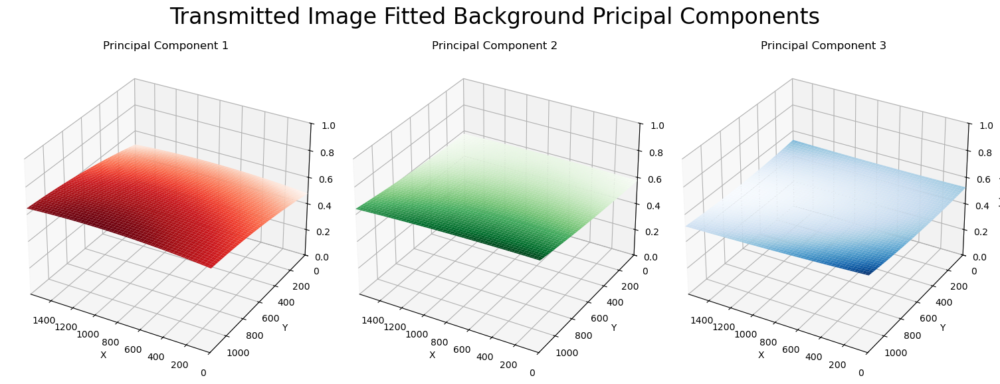

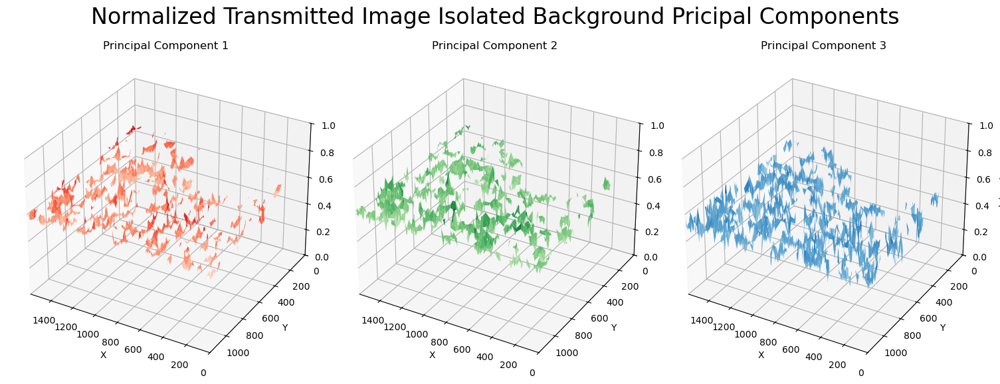

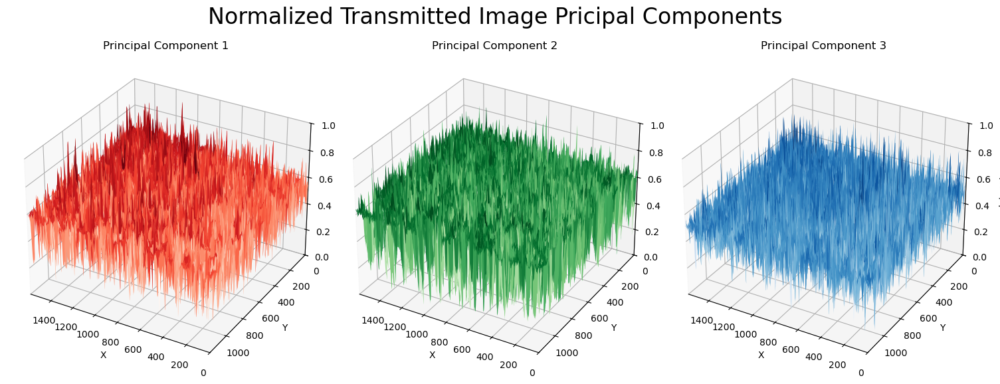

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.013401493..1.0068207].


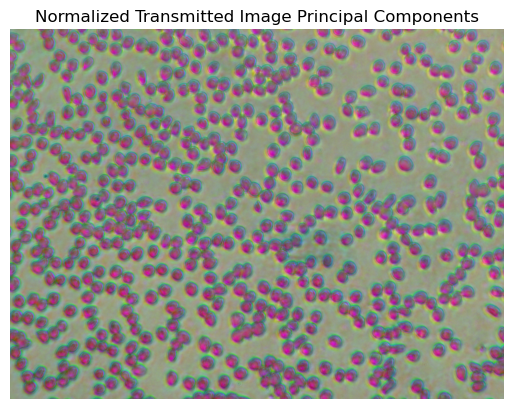

Gathered Results


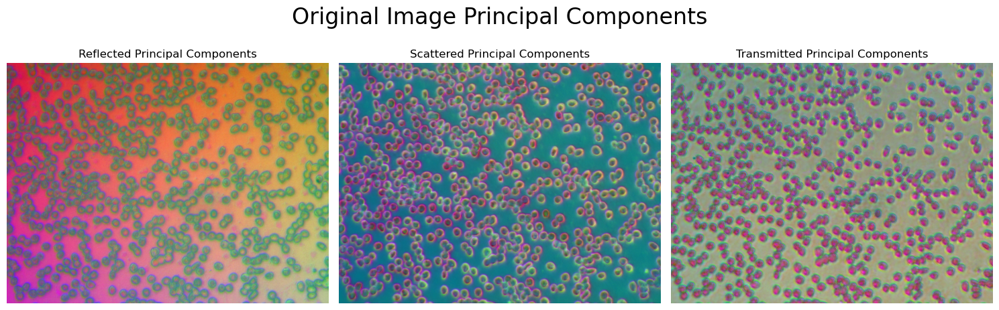

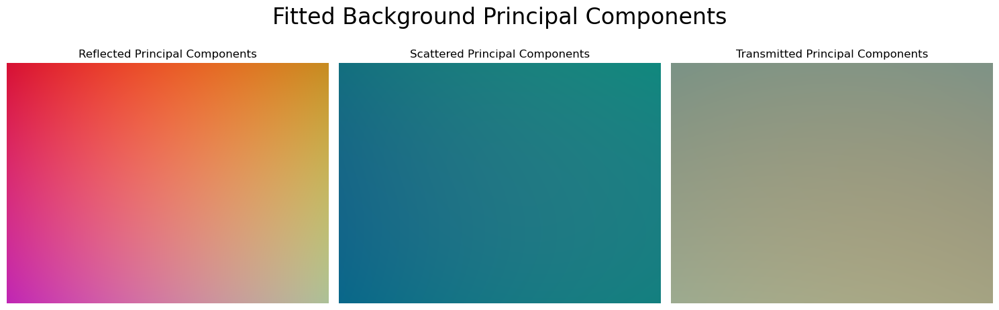

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007826647..0.97353786].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.013401493..1.0068207].


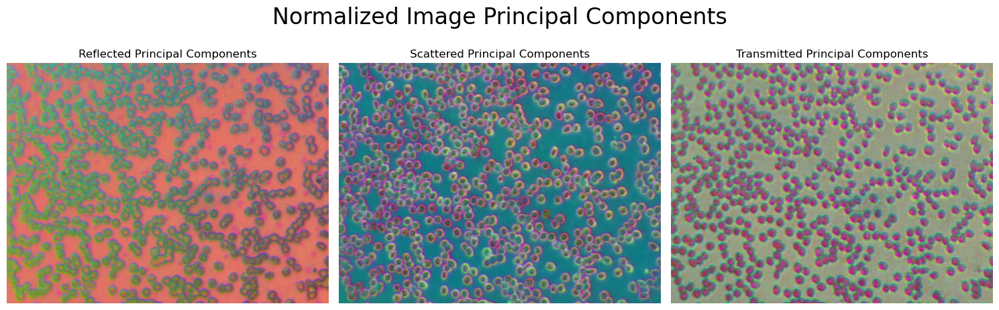

In [63]:
# Rescale normalized image and background for cohesive plotting, scale to [0,1] w.r.t. minimum and maximum from original image principal components
principal_components_normalized_image_R = (principal_components_normalized_image_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]
principal_components_normalized_image_S = (principal_components_normalized_image_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]
principal_components_normalized_image_T = (principal_components_normalized_image_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

principal_components_fitted_background_R = (principal_components_fitted_background_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]
principal_components_fitted_background_S = (principal_components_fitted_background_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]
principal_components_fitted_background_T = (principal_components_fitted_background_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

def plot_surface_channels(image, title, mask=None):
    # Create grid for X, Y coordinates
    H, W = image.shape[1:]
    x = np.arange(W)
    y = np.arange(H)
    x, y = np.meshgrid(x, y)

    if not mask is None:
        component_1 = np.where(mask == 0, image[0], np.nan)
        component_2 = np.where(mask == 0, image[1], np.nan)
        component_3 = np.where(mask == 0, image[2], np.nan)
    else:
        component_1 = image[0]
        component_2 = image[1]
        component_3 = image[2]

    fig = plt.figure(figsize=(15, 6))
    # Plot component 1 in x-z plane
    ax1 = fig.add_subplot(131, projection='3d')
    ax1.plot_surface(x, y, component_1, cmap='Reds', edgecolor='none')
    ax1.set_title('Principal Component 1')
    ax1.set_xlabel('X')
    ax1.set_xlim(W-1, 0)
    ax1.set_ylabel('Y')
    ax1.set_ylim(H-1, 0)
    ax1.set_zlabel('Intensity')
    ax1.set_zlim([0, 1])
    # Plot component 2 in y-z plane
    ax2 = fig.add_subplot(132, projection='3d')
    ax2.plot_surface(x, y, component_2, cmap='Greens', edgecolor='none')
    ax2.set_title('Principal Component 2')
    ax2.set_xlabel('X')
    ax2.set_xlim(W-1, 0)
    ax2.set_ylabel('Y')
    ax2.set_ylim(H-1, 0)
    ax2.set_zlabel('Intensity')
    ax2.set_zlim([0, 1])
    # Plot component 3 in x-y plane
    ax3 = fig.add_subplot(133, projection='3d')
    ax3.plot_surface(x, y, component_3, cmap='Blues', edgecolor='none')
    ax3.set_title('Principal Component 3')
    ax3.set_xlabel('X')
    ax3.set_xlim(W-1, 0)
    ax3.set_ylabel('Y')
    ax3.set_ylim(H-1, 0)
    ax3.set_zlabel('Intensity')
    ax3.set_zlim([0, 1])
    plt.suptitle(title, fontsize=24)
    plt.tight_layout()
    plt.show()

print("Reflected Image Normalization")
plt.imshow(principal_components_image_R.transpose(1, 2, 0))
plt.axis(False)
plt.title('Reflected Image Principal Components')
plt.show()
plot_surface_channels(principal_components_image_R, "Original Reflected Image Pricipal Components")
plot_surface_channels(principal_components_image_R, "Reflected Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_fitted_background_R, "Reflected Image Fitted Background Pricipal Components")
plot_surface_channels(principal_components_normalized_image_R, "Normalized Reflected Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_normalized_image_R, "Normalized Reflected Image Pricipal Components")
plt.imshow(principal_components_normalized_image_R.transpose(1, 2, 0))
plt.axis(False)
plt.title('Normalized Reflected Image Principal Components')
plt.show()

print("Scattered Image Normalization")
plt.imshow(principal_components_image_S.transpose(1, 2, 0))
plt.axis(False)
plt.title('Reflected Image Principal Components')
plt.show()
plot_surface_channels(principal_components_image_S, "Original Scattered Image Pricipal Components")
plot_surface_channels(principal_components_image_S, "Scattered Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_fitted_background_S, "Scattered Image Fitted Background Pricipal Components")
plot_surface_channels(principal_components_normalized_image_S, "Normalized Scattered Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_normalized_image_S, "Normalized Scattered Image Pricipal Components")
plt.imshow(principal_components_normalized_image_S.transpose(1, 2, 0))
plt.axis(False)
plt.title('Normalized Scattered Image Principal Components')
plt.show()

print("Transmitted Image Normalization")
plt.imshow(principal_components_image_T.transpose(1, 2, 0))
plt.axis(False)
plt.title('Reflected Image Principal Components')
plt.show()
plot_surface_channels(principal_components_image_T, "Original Transmitted Image Pricipal Components")
plot_surface_channels(principal_components_image_T, "Transmitted Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_fitted_background_T, "Transmitted Image Fitted Background Pricipal Components")
plot_surface_channels(principal_components_normalized_image_T, "Normalized Transmitted Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_normalized_image_T, "Normalized Transmitted Image Pricipal Components")
plt.imshow(principal_components_normalized_image_T.transpose(1, 2, 0))
plt.axis(False)
plt.title('Normalized Transmitted Image Principal Components')
plt.show()

print("Gathered Results")

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Original Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_fitted_background_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_fitted_background_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_fitted_background_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Fitted Background Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_normalized_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_normalized_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_normalized_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Normalized Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

To check how well the normalization worked, we can fit a new PCA to better see remaining variance in the now normalized 13-channel image. 

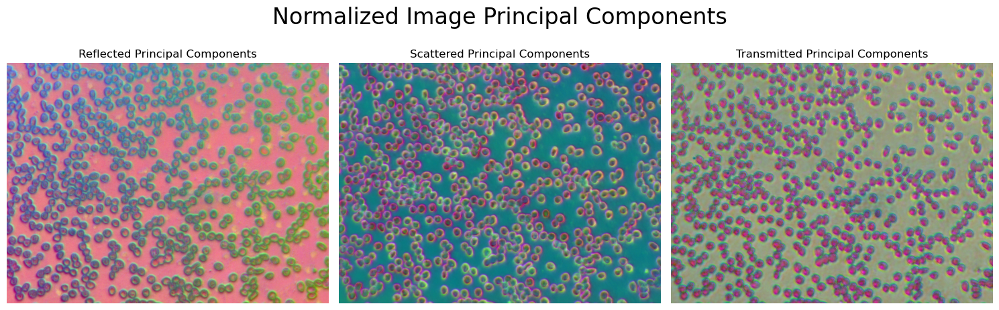

In [64]:
# Fit PCA models to image and compute principal components
norm_pca_R = ImagePCA()
norm_pca_S = ImagePCA()
norm_pca_T = ImagePCA()
norm_pca_R.fit(normalized_image_R)
norm_pca_S.fit(normalized_image_S)
norm_pca_T.fit(normalized_image_T)
principal_components_normalized_image_R = norm_pca_R.transform(normalized_image_R)[0]
principal_components_normalized_image_S = norm_pca_S.transform(normalized_image_S)[0]
principal_components_normalized_image_T = norm_pca_T.transform(normalized_image_T)[0]

# Rescale images to range [0,1]
norm_min_R = np.min(principal_components_normalized_image_R, (1,2))
norm_max_R = np.max(principal_components_normalized_image_R, (1,2))
principal_components_normalized_image_R = (principal_components_normalized_image_R - norm_min_R[:, None, None]) / (norm_max_R - norm_min_R)[:, None, None]
norm_min_S = np.min(principal_components_normalized_image_S, (1,2))
norm_max_S = np.max(principal_components_normalized_image_S, (1,2))
principal_components_normalized_image_S = (principal_components_normalized_image_S - norm_min_S[:, None, None]) / (norm_max_S - norm_min_S)[:, None, None]
norm_min_T = np.min(principal_components_normalized_image_T, (1,2))
norm_max_T = np.max(principal_components_normalized_image_T, (1,2))
principal_components_normalized_image_T = (principal_components_normalized_image_T - norm_min_T[:, None, None]) / (norm_max_T - norm_min_T)[:, None, None]

# Plot results
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_normalized_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_normalized_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_normalized_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Normalized Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

At the moment, I am missing a quantitative evaluation method of how well this normalization works for RBCs. Visually, it creates a uniform background in principal component space, which could suggest that individual RBCs have been normalized. But to verify this, a quantative evaluation method in some form is needed. Potentially compute spectral signatures of individual cells and compare. This would however assume that all RBCs have similar signatures. 

A second observation is the normalization of the reflected channels. If we normalize w.r.t. the background, we end up with cells differing in intensity in the principal components. I think that there might be some angular dependency of the background and the lens capturing the image, and if so that a uniform background may be undesirable. The background before normalization forms a smooth spectrum, which I think could correspond to reflected light at different angles. If we want to keep this angular dependency, we could for instance estimate the background plane over multiple images and normalize w.r.t. the average plane. 

# Normalizing over multiple images

To see how well we can expect this normalization to work over different images, we try normalizing a set of random images from the dataset. 

In [65]:
# Define the number of elements to evaluate (e.g., first 5 elements)
n_images = 5
random_idxs = np.random.randint(0, len(dataset), n_images)
# random_idxs = [72] + list(np.random.randint(0, len(dataset), n_images))

# Store results in lists for later comparison
image_R_list = []
image_S_list = []
image_T_list = []

normalized_image_R_list = []
normalized_image_S_list = []
normalized_image_T_list = []

fitted_background_R_list = []
fitted_background_S_list = []
fitted_background_T_list = []

segmentation_model = models.Cellpose(model_type='cyto3', gpu=True, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

# Loop through the first `num_elements` images in the dataset
for i, idx in enumerate(random_idxs):
    print(f"Image {i+1}/{n_images}: {idx}")

    # Retrieve the dataset element
    data = dataset[idx]

    # Extract the images for each channel
    image_R = data['R']
    image_S = data['S']
    image_T = data['T']

    # Compute background binary mask
    background_mask = get_background_mask(image_R, image_S, image_T, segmentation_model, plot=False)

    # Normalize images by fitting polynomial background
    normalized_image_R, fitted_background_R = fit_polynomial_background(image_R, background_mask)
    normalized_image_S, fitted_background_S = fit_polynomial_background(image_S, background_mask)
    normalized_image_T, fitted_background_T = fit_polynomial_background(image_T, background_mask)

    # Store results
    image_R_list.append(image_R)
    image_S_list.append(image_S)
    image_T_list.append(image_T)
    
    normalized_image_R_list.append(normalized_image_R)
    normalized_image_S_list.append(normalized_image_S)
    normalized_image_T_list.append(normalized_image_T)
    
    fitted_background_R_list.append(fitted_background_R)
    fitted_background_S_list.append(fitted_background_S)
    fitted_background_T_list.append(fitted_background_T)

# Reshape into numpy arrays
images = np.stack([np.stack(image_R_list), 
                   np.stack(image_S_list), 
                   np.stack(image_T_list)])

normalized_images = np.stack([np.stack(normalized_image_R_list), 
                              np.stack(normalized_image_S_list), 
                              np.stack(normalized_image_T_list)])

fitted_backgrounds = np.stack([np.stack(fitted_background_R_list), 
                               np.stack(fitted_background_S_list), 
                               np.stack(fitted_background_T_list)])

c:\Users\ollee\anaconda3\envs\MultispectralMalariaProject\Lib\site-packages\cellpose\resnet_torch.py:271: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.lo

Image 1/5: 65
Image 2/5: 79
Image 3/5: 39
Image 4/5: 103
Image 5/5: 4


Before plotting results, we compute principal components for compact visualization

(3, 5, 3, 1200, 1600)


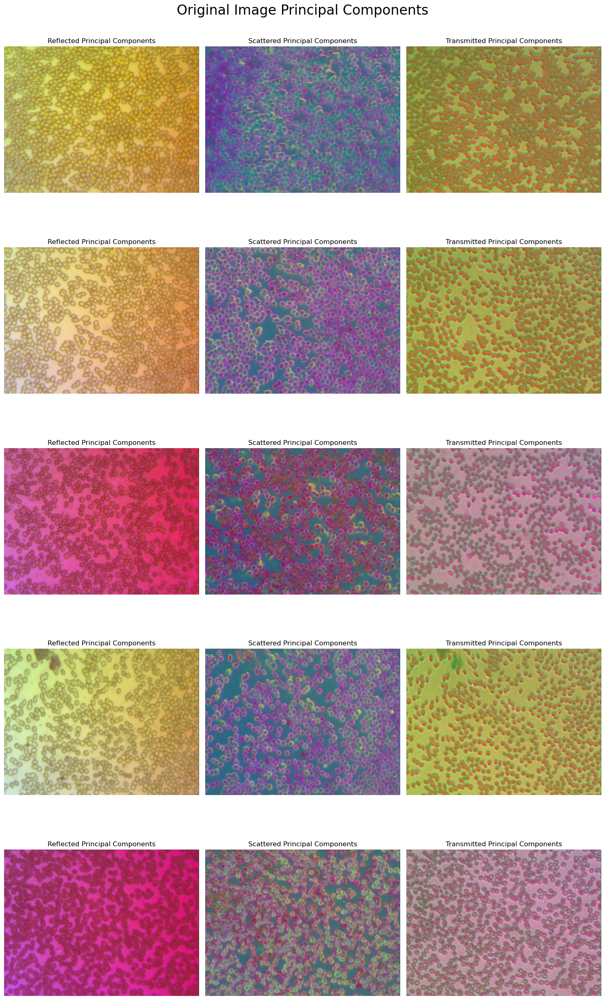

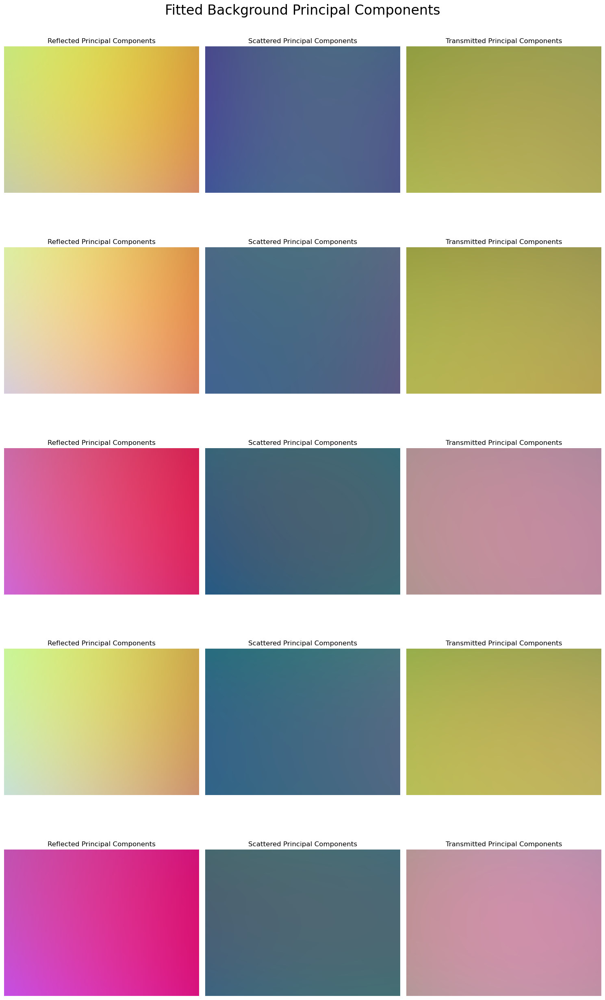

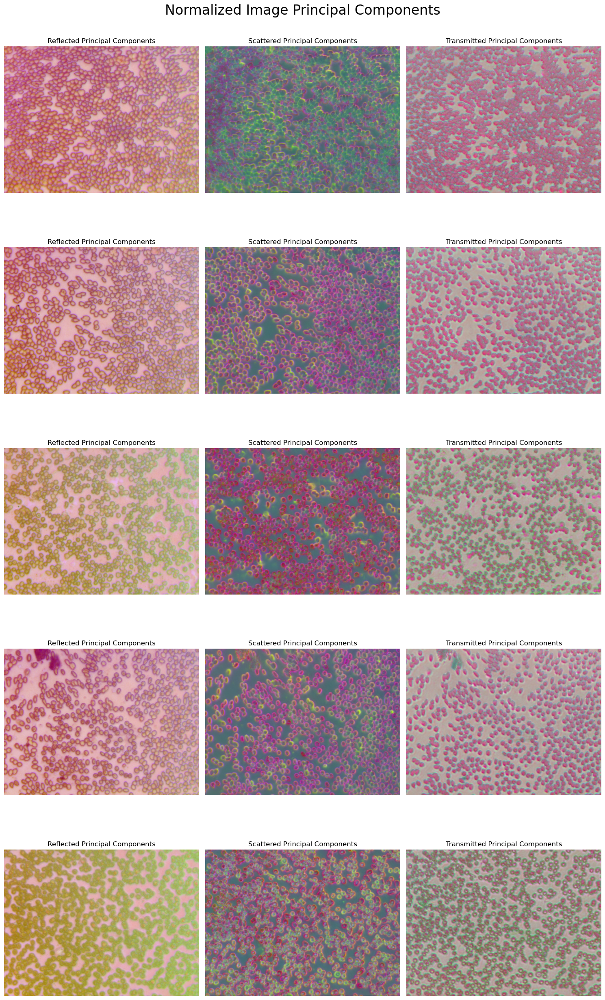

In [66]:
# Initialize PCA for each channel
pca_R = ImagePCA(n_components=3)
pca_S = ImagePCA(n_components=3)
pca_T = ImagePCA(n_components=3)

# Fit PCA to each image
pca_R.fit(images[0])
pca_S.fit(images[1])
pca_T.fit(images[2])

# Compute principal components of results
principal_components_images = np.stack([pca.transform(image) for (image, pca) in zip(images, [pca_R, pca_S, pca_T])])
principal_components_normalized_images = np.stack([pca.transform(image) for (image, pca) in zip(normalized_images, [pca_R, pca_S, pca_T])])
principal_components_fitted_backgrounds = np.stack([pca.transform(image) for (image, pca) in zip(fitted_backgrounds, [pca_R, pca_S, pca_T])])
print(principal_components_images.shape)

# Compute min and max values before and after normalization
min_principal = np.min(principal_components_images, (1,3,4))
max_principal = np.max(principal_components_images, (1,3,4))
min_norm_principal = np.min(principal_components_normalized_images, (1,3,4))
max_norm_principal = np.max(principal_components_normalized_images, (1,3,4))

# Rescale principal components to range [0,1]
principal_components_images = (principal_components_images - min_principal[:,None,:,None,None]) / (max_principal - min_principal)[:,None,:,None,None]
principal_components_normalized_images = (principal_components_normalized_images - min_norm_principal[:,None,:,None,None]) / (max_norm_principal - min_norm_principal)[:,None,:,None,None]
principal_components_fitted_backgrounds = (principal_components_fitted_backgrounds - min_principal[:,None,:,None,None]) / (max_principal - min_principal)[:,None,:,None,None]

# Plot results
fig, axs = plt.subplots(n_images, 3, figsize=(15, n_images*5+1))
for i in range(n_images):
    axs[i, 0].imshow(principal_components_images[0,i].transpose(1, 2, 0))
    axs[i, 1].imshow(principal_components_images[1,i].transpose(1, 2, 0))
    axs[i, 2].imshow(principal_components_images[2,i].transpose(1, 2, 0))
    axs[i, 0].set_title("Reflected Principal Components")
    axs[i, 1].set_title("Scattered Principal Components")
    axs[i, 2].set_title("Transmitted Principal Components")
for ax in axs.flatten():
    ax.axis(False)
plt.suptitle("Original Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(n_images, 3, figsize=(15, n_images*5+1))
for i in range(n_images):
    axs[i, 0].imshow(principal_components_fitted_backgrounds[0,i].transpose(1, 2, 0))
    axs[i, 1].imshow(principal_components_fitted_backgrounds[1,i].transpose(1, 2, 0))
    axs[i, 2].imshow(principal_components_fitted_backgrounds[2,i].transpose(1, 2, 0))
    axs[i, 0].set_title("Reflected Principal Components")
    axs[i, 1].set_title("Scattered Principal Components")
    axs[i, 2].set_title("Transmitted Principal Components")
for ax in axs.flatten():
    ax.axis(False)
plt.suptitle("Fitted Background Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(n_images, 3, figsize=(15, n_images*5+1))
for i in range(n_images):
    axs[i, 0].imshow(principal_components_normalized_images[0,i].transpose(1, 2, 0))
    axs[i, 1].imshow(principal_components_normalized_images[1,i].transpose(1, 2, 0))
    axs[i, 2].imshow(principal_components_normalized_images[2,i].transpose(1, 2, 0))
    axs[i, 0].set_title("Reflected Principal Components")
    axs[i, 1].set_title("Scattered Principal Components")
    axs[i, 2].set_title("Transmitted Principal Components")
for ax in axs.flatten():
    ax.axis(False)
plt.suptitle("Normalized Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()